# **Name: Md Saimon Siddqiue**
## **Data Science and Business Analytics**
### Task-3 : Exploratory Data Analysis - Retail
Problem Statement:
##### *● Perform ‘Exploratory Data Analysis’ on dataset ‘SampleSuperstore’*
##### *● As a business manager, try to find out the weak areas where you can work to make more profit.*
##### *● What all business problems you can derive by exploring the data?*


In [1]:
# Importing Libraries
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings('ignore')

## Loading the Store dataset

In [2]:
# Importing Dataset

sd_df = pd.read_csv("Storedata.csv")

**Before doing data visualization Let's Explore data first**

 ## Data Exploration

In [3]:
sd_df.head()

,Ship Mode,Segment,Country,City,State,Postal Code,Region,Category,Sub-Category,Sales,Quantity,Discount,Profit
0,Second Class,Consumer,United States,Henderson,Kentucky,42420,South,Furniture,Bookcases,261.9600,2,0.00,41.9136
1,Second Class,Consumer,United States,Henderson,Kentucky,42420,South,Furniture,Chairs,731.9400,3,0.00,219.5820
2,Second Class,Corporate,United States,Los Angeles,California,90036,West,Office Supplies,Labels,14.6200,2,0.00,6.8714
3,Standard Class,Consumer,United States,Fort Lauderdale,Florida,33311,South,Furniture,Tables,957.5775,5,0.45,-383.0310
4,Standard Class,Consumer,United States,Fort Lauderdale,Florida,33311,South,Office Supplies,Storage,22.3680,2,0.20,2.5164


In [4]:
sd_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9994 entries, 0 to 9993
Data columns (total 13 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   Ship Mode     9994 non-null   object 
 1   Segment       9994 non-null   object 
 2   Country       9994 non-null   object 
 3   City          9994 non-null   object 
 4   State         9994 non-null   object 
 5   Postal Code   9994 non-null   int64  
 6   Region        9994 non-null   object 
 7   Category      9994 non-null   object 
 8   Sub-Category  9994 non-null   object 
 9   Sales         9994 non-null   float64
 10  Quantity      9994 non-null   int64  
 11  Discount      9994 non-null   float64
 12  Profit        9994 non-null   float64
dtypes: float64(3), int64(2), object(8)
memory usage: 1015.1+ KB


In [5]:
sd_df.shape

(9994, 13)

In [6]:
#Detailed view of dataset
sd_df.describe()

,Postal Code,Sales,Quantity,Discount,Profit
count,9994.000000,9994.000000,9994.000000,9994.000000,9994.000000
mean,55190.379428,229.858001,3.789574,0.156203,28.656896
std,32063.693350,623.245101,2.225110,0.206452,234.260108
min,1040.000000,0.444000,1.000000,0.000000,-6599.978000
25%,23223.000000,17.280000,2.000000,0.000000,1.728750
50%,56430.500000,54.490000,3.000000,0.200000,8.666500
75%,90008.000000,209.940000,5.000000,0.200000,29.364000
max,99301.000000,22638.480000,14.000000,0.800000,8399.976000


In [7]:
#Check for duplicate values
print('No. of duplicated values :', sd_df.duplicated().sum())

No. of duplicated values : 17


In [8]:
# Removing Duplicates
sd_df = sd_df.drop_duplicates()
sd_df.head()

,Ship Mode,Segment,Country,City,State,Postal Code,Region,Category,Sub-Category,Sales,Quantity,Discount,Profit
0,Second Class,Consumer,United States,Henderson,Kentucky,42420,South,Furniture,Bookcases,261.9600,2,0.00,41.9136
1,Second Class,Consumer,United States,Henderson,Kentucky,42420,South,Furniture,Chairs,731.9400,3,0.00,219.5820
2,Second Class,Corporate,United States,Los Angeles,California,90036,West,Office Supplies,Labels,14.6200,2,0.00,6.8714
3,Standard Class,Consumer,United States,Fort Lauderdale,Florida,33311,South,Furniture,Tables,957.5775,5,0.45,-383.0310
4,Standard Class,Consumer,United States,Fort Lauderdale,Florida,33311,South,Office Supplies,Storage,22.3680,2,0.20,2.5164


## **Checking for missing**

In [9]:
null_values =sd_df.isna().sum().to_frame('Null Values')
print(null_values)

              Null Values
Ship Mode               0
Segment                 0
Country                 0
City                    0
State                   0
Postal Code             0
Region                  0
Category                0
Sub-Category            0
Sales                   0
Quantity                0
Discount                0
Profit                  0


**No missing value in the dataset**

In [10]:
#NUMBER OF UNIQUE VALUES PER COLUMN
sd_df.nunique()

Ship Mode          4
Segment            3
Country            1
City             531
State             49
Postal Code      631
Region             4
Category           3
Sub-Category      17
Sales           5825
Quantity          14
Discount          12
Profit          7287
dtype: int64

#### ● There are only 4 types of shipping mode to examine
#### ● There are 3 segments in dataset

In [11]:
# Dropping Unnecessary columns from the Dataset
sd_df = sd_df.drop(columns=['Postal Code', 'Country'], axis=1)
sd_df.head()

,Ship Mode,Segment,City,State,Region,Category,Sub-Category,Sales,Quantity,Discount,Profit
0,Second Class,Consumer,Henderson,Kentucky,South,Furniture,Bookcases,261.9600,2,0.00,41.9136
1,Second Class,Consumer,Henderson,Kentucky,South,Furniture,Chairs,731.9400,3,0.00,219.5820
2,Second Class,Corporate,Los Angeles,California,West,Office Supplies,Labels,14.6200,2,0.00,6.8714
3,Standard Class,Consumer,Fort Lauderdale,Florida,South,Furniture,Tables,957.5775,5,0.45,-383.0310
4,Standard Class,Consumer,Fort Lauderdale,Florida,South,Office Supplies,Storage,22.3680,2,0.20,2.5164


In [12]:
#Taking a look at our data again

sd_df.describe()

,Sales,Quantity,Discount,Profit
count,9977.000000,9977.000000,9977.000000,9977.00000
mean,230.148902,3.790719,0.156278,28.69013
std,623.721409,2.226657,0.206455,234.45784
min,0.444000,1.000000,0.000000,-6599.97800
25%,17.300000,2.000000,0.000000,1.72620
50%,54.816000,3.000000,0.200000,8.67100
75%,209.970000,5.000000,0.200000,29.37200
max,22638.480000,14.000000,0.800000,8399.97600


## Data Visualization

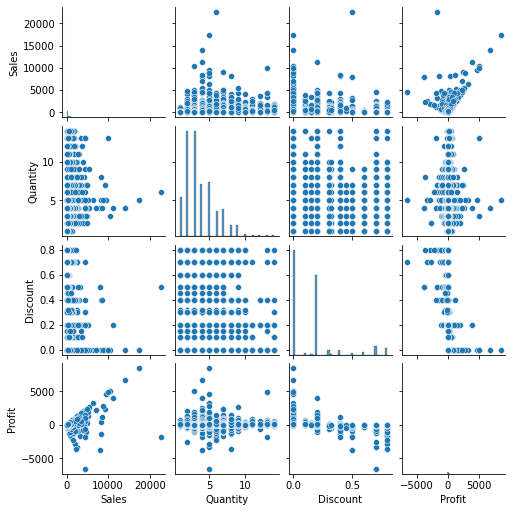

In [13]:
sns.pairplot(data=sd_df, height=1.8)
plt.show()

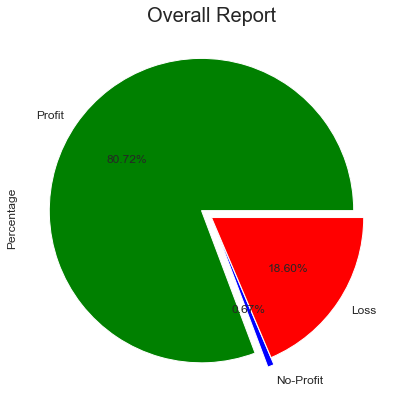

In [35]:
# Plotting Overall Sales Summary
summary = pd.DataFrame({'Profit':sd_df.Quantity[sd_df.Profit > 0].sum(), 
                        'No-Profit':sd_df.Quantity[sd_df.Profit == 0].sum(), 
                        'Loss':sd_df.Quantity[(-sd_df.Profit) > 0].sum()},
                       index={'Count'}).T
plt.title('Overall Report', fontsize=20)
summary.Count.plot.pie(autopct='%.2f%%',figsize=(7,7), label='Percentage', 
                       textprops = {"fontsize":12}, colors = ['green', 'blue', 'red'],shadow=False, explode=(0.08,0.05,0))
plt.show()

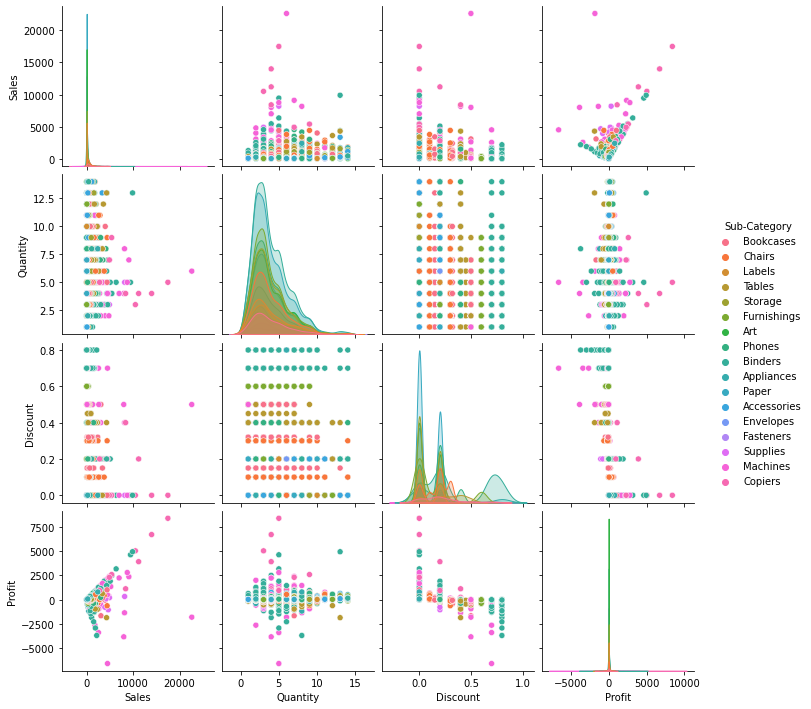

In [15]:
sns.pairplot(sd_df,hue='Sub-Category')
plt.show()

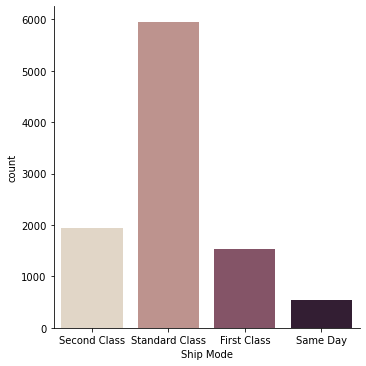

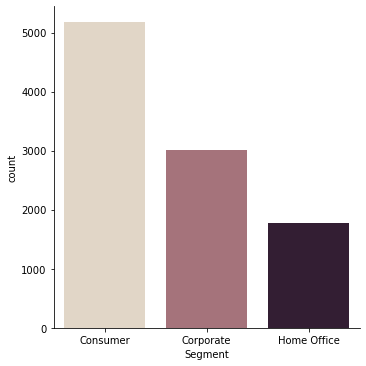

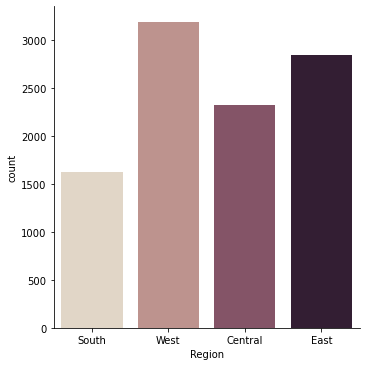

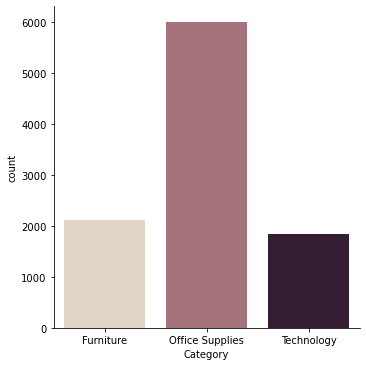

In [16]:
#PLOTTING CATEGORICAL VARIABLES
categorical_features=[feature for feature in sd_df.columns if sd_df[feature].dtype=='O' ]
for feature in categorical_features:
    if feature not in ['State','City','Sub-Category']:
        sns.catplot(x=feature, kind="count", palette="ch:.25", data=sd_df)

In [17]:
#Let's see the which states have top sales and Profits
top_sales = sd_df.groupby("State").Sales.sum().nlargest(n=5)
top_profits = sd_df.groupby("State").Profit.sum().nlargest(n=5)

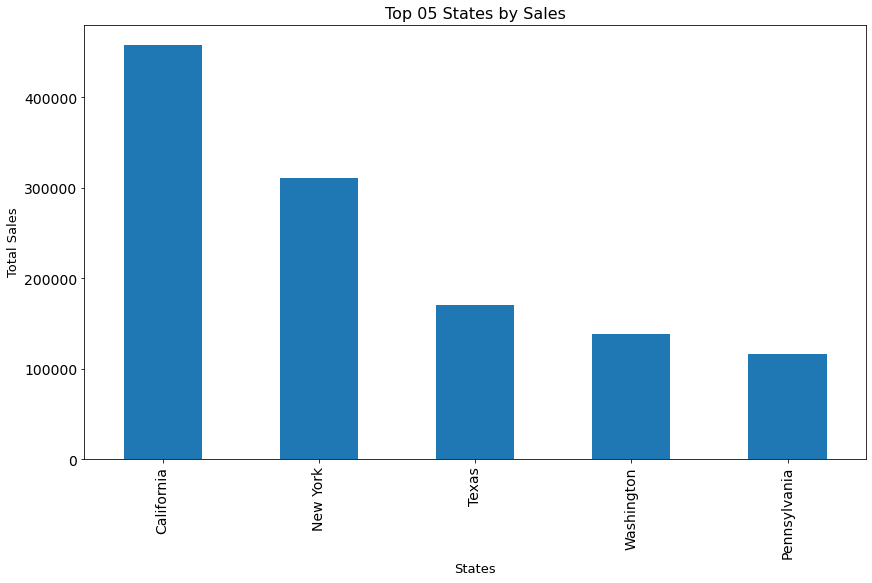

In [18]:
#Top 5 states by Sales
top_sales.plot(kind ='bar', figsize =(14,8), fontsize =14)
plt.xlabel("States", fontsize =13)
plt.ylabel("Total Sales",fontsize =13)
plt.title("Top 05 States by Sales",fontsize =16)
plt.show()

**California is having the highest sale.**

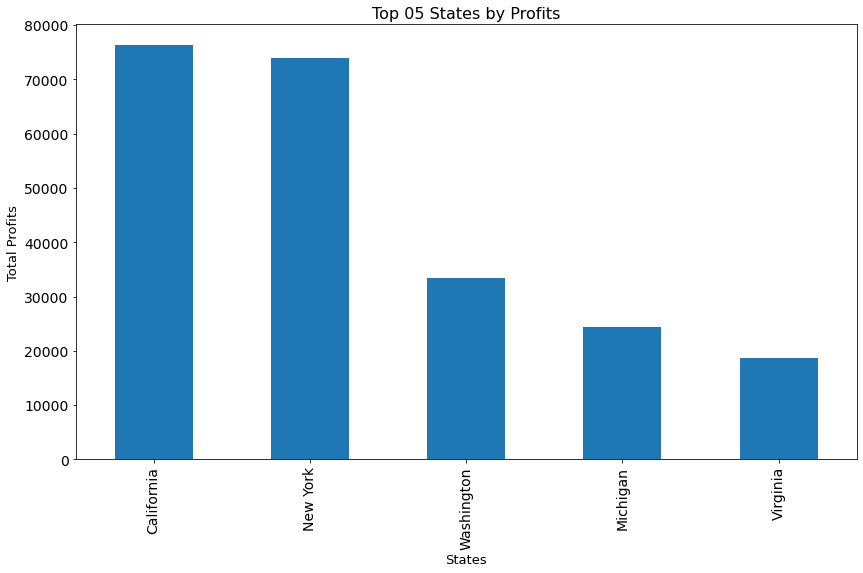

In [19]:
#Top 5 states by Profits
top_profits.plot(kind ='bar', figsize =(14,8), fontsize =14)
plt.xlabel("States", fontsize =13)
plt.ylabel("Total Profits",fontsize =13)
plt.title("Top 05 States by Profits",fontsize =16)
plt.show()

**California is having the highest Profit.**

#### California and New York are far ahead of any other states in terms of profit as well as sales.

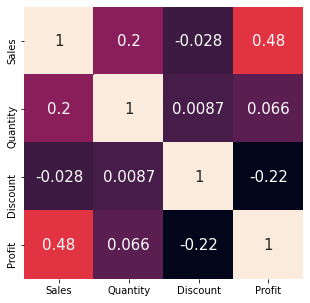

In [20]:
#Correlation
plt.figure(figsize=(5,5))
sns.heatmap(sd_df.corr(), annot=True, cbar=False, annot_kws={'size':15})
plt.show()

## **Profit vs Sales Analysis**

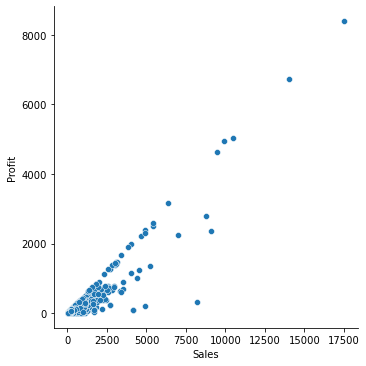

In [21]:
#When dicount is 0
df=sd_df[sd_df['Discount']==0]
sns.relplot(x='Sales',y='Profit',data=df)

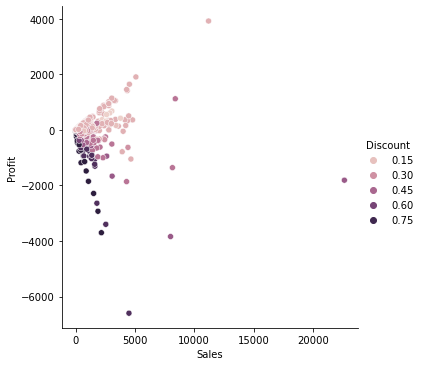

In [22]:
#When discount is not zero
df_new=sd_df[sd_df['Discount']!=0]
sns.relplot(x='Sales',y='Profit',hue='Discount',data=df_new)

<AxesSubplot:xlabel='Sub-Category'>

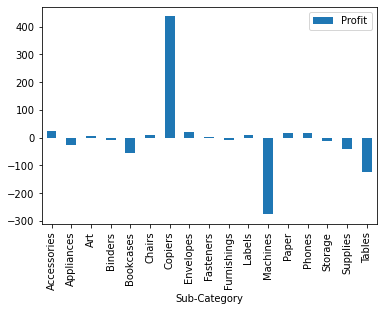

In [23]:
#Profit distribution by sub-category
pivot=pd.pivot_table(df_new,index='Sub-Category',values='Profit')
pivot.plot(kind='bar')

We can see from the pivot that copiers had highest Profit and Machines had highest loss

<AxesSubplot:xlabel='Sub-Category'>

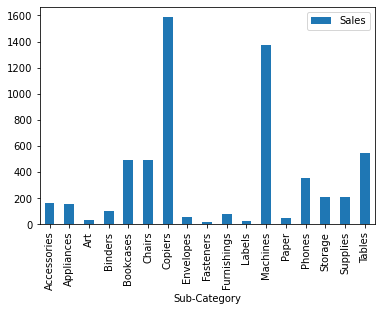

In [24]:
#Sales distribution by sub-category
pivot=pd.pivot_table(df_new,index='Sub-Category',values='Sales')
pivot.plot(kind='bar')

#### We see that copiers had highest sale and Machines had second highest sales.

#### If we observe the above pivots, we can see that 'Machines' had second highest sale but due to large discounts it is in loss and in second graph we can see that sales in 'Fasteners','labels'and 'Art' category are so weak.so we have to concentrate on these sub-category businesses

### Thus, Discounts are triggering losses.

## Now Let's do CATEGORY WISE ANALYSIS

<AxesSubplot:xlabel='Category'>

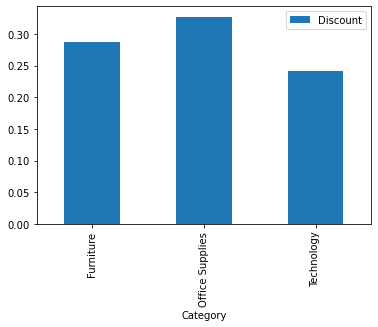

In [25]:
#Discount
pivot=pd.pivot_table(df_new,index='Category',values='Discount')
pivot.plot(kind='bar')

<AxesSubplot:xlabel='Category'>

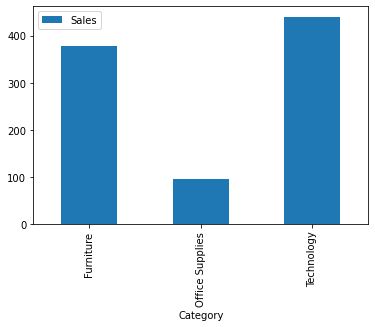

In [26]:
#Sales
pivot=pd.pivot_table(df_new,index='Category',values='Sales')
pivot.plot(kind='bar')

<AxesSubplot:xlabel='Category'>

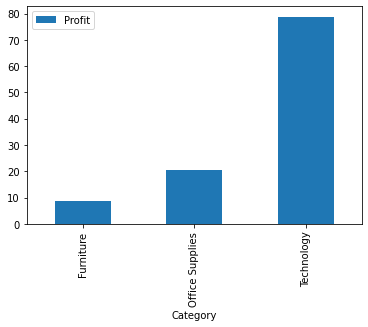

In [27]:
#Profits
pivot=pd.pivot_table(sd_df,index='Category',values='Profit')
pivot.plot(kind='bar')

<p>From Above Analysis we have noticed that:</p>

<ol>
    <li>Most Discount is given in Furniture category and less Discount is given in Technology category businesses.</li>
    <li>Sales in Technology category is highest.</li>
    <li>Profit in Technology category is higher than any other category.</li>
</ol>


## DISTRIBUTION BY REGION

In [28]:
region_wise = sd_df.groupby('Region')[['Profit','Sales','Discount']].sum()
region_wise.head()

,Profit,Sales,Discount
Region,,,
Central,39655.8752,500782.8528,557.14
East,91506.3092,678435.1960,413.50
South,46749.4303,391721.9050,238.55
West,108329.8079,725255.6365,350.00


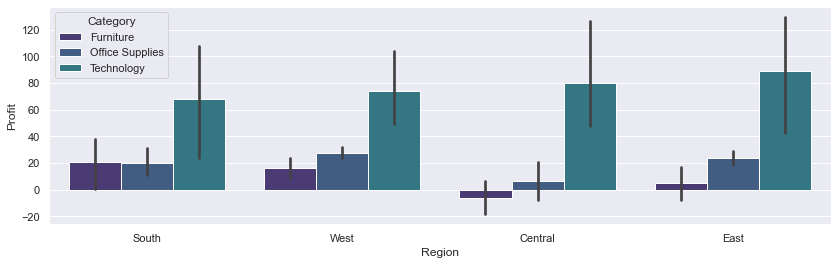

In [29]:
plt.figure(figsize = (14,4))
sns.set(font_scale=1, palette= "viridis")
sns.barplot(data = sd_df , x = "Region",y = "Profit" ,hue = "Category")
plt.show()

 **Observing the above plotting, "Furniture" Category is the only loss making sector that to only in Central Region.**

## Let's Investigate the reason for losses in the Central region

In [30]:
#Grouping Data by Region and only slicing Data for Central Region from whole Data Set
Central = list(sd_df.groupby("Region"))[0][1]

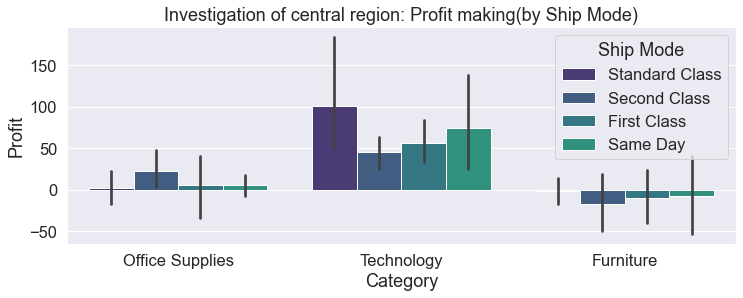

In [31]:
# Investing if shipmode has any effect in central Region 
plt.figure(figsize = (12,4))
sns.set(font_scale=1.5, palette= "viridis")
sns.barplot(data =Central, x = "Category",y = "Profit" ,hue = "Ship Mode")
plt.title("Investigation of central region: Profit making(by Ship Mode)")
plt.show()

The mode of shipping doesn't affect much. Losses incurred in Furniture Category are irrespective of shipping mode in Central Region.

** As we can see that shipmode does not affect much. Let's investigate individual by states in the central region in sale of furniture.**

In [32]:
# Slicing Furniture Data from whole data set
Category_Furniture =list(list(sd_df.groupby("Region"))[0][1].groupby("Category"))[0][1]

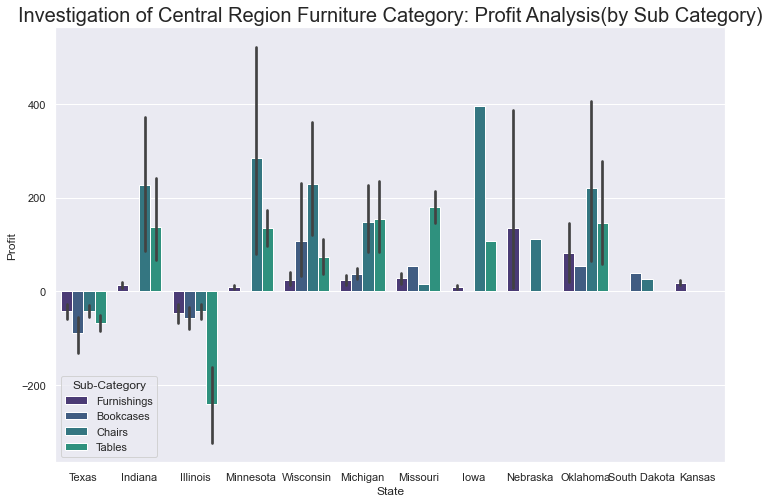

In [33]:
plt.figure(figsize = (12,8))
sns.set(font_scale=1, palette= "viridis")
sns.barplot(data = Category_Furniture , x = "State",y = "Profit" ,hue = "Sub-Category")
plt.title("Investigation of Central Region Furniture Category: Profit Analysis(by Sub Category)", fontsize = 20)
plt.show()

** Texas and Illinois are only two states contributing to all the losses in Furniture category in the Central Region.**

## Now Let's See What are the causes behind this Loss? 

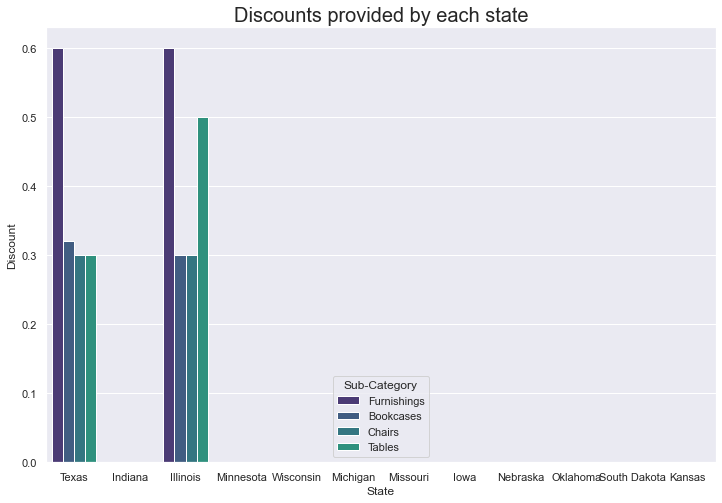

In [34]:
#Let's see the discount provided by the states
plt.figure(figsize = (12,8))
sns.set(font_scale=1, palette= "viridis")
sns.barplot(data = Category_Furniture , x = "State",y = "Discount" ,hue = "Sub-Category")
plt.title("Discounts provided by each state", fontsize = 20)
plt.show()

### Texas and Illinois are two only states providing discounts in the whole central region.

## Findings:
<ul>
    <li><b>When discount increases, Sales increases but profit decreases.<b></li>
    <li><b>In Technology category business we get more Profit as compared to other two business.This is because of we have given less Discount.</b></li>
    <li><b>Central region facing more loss in sales compared with others.</b></li>
    <li><b>Texas & Illinois are the States where overall sales are in loss and particularly for furniture.</b></li>
    <li><b>Also Sales in 'Fasteners','labels'and 'Art' category are so weak.</b></li>
    <li><b>Office Supplies category sales is less as compared to other two.</b></li>
</ul>

## Conclusion:
<ul>
    <li><b>The product must sell with low/no discount to become the best profitable.</b></li>
    <li><b>For enhancing the profits, Better to minimize supplying Furniture(Tables & Bookcases) and the items in other categories that result in loss.</b></li>
    <li><b>Texas & Illinois must drop the supply of furniture, items in Technology will enhance their profit <b></li>
</ul>